PS6: Tracking

1 Particle Filter Tracking: track an image patch template (a face) taken from the first frame
of the video. For this assignment the model is simply going to be the image patch, and the state
will be only the 2D center location of the patch. Mean Squared Error will be used as dissimilarity between the image patch and a window of equal size in the
current image. We will use a Gaussian to convert this into a usable measurement function. Sigma MSE = 10

In [1]:
import numpy as np
import cv2 as cv
import matplotlib
import matplotlib.pyplot as plt


In [2]:
def process_video(video_path):
    # Open the video
    cap = cv.VideoCapture(video_path)

    # Initialize the list of frames
    frames = []

    # Read and process each frame
    while True:
        ret, frame = cap.read()

        if not ret:
            break  # End of the video

        # Convert the frame to RGB format
        rgb_frame = cv.cvtColor(frame, cv.COLOR_BGR2RGB)

        # Store the frame in the list
        frames.append(rgb_frame)

    # Release resources
    cap.release()

    return frames

Object bounding box at the first frame: top-left coordinate (not center) and the size (width & height) of the bounding box.

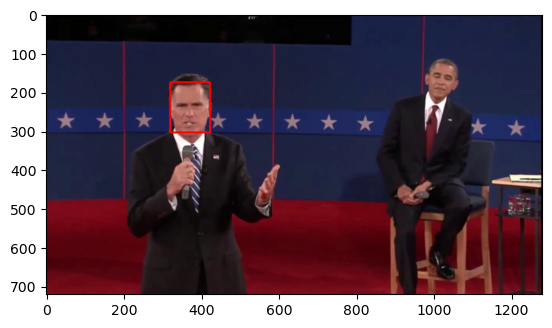

In [3]:
# Read the first frame in RGB
frames_debate= process_video('pres_debate.avi')

# Read the object bounding box parameters from the press_debate.txt file
with open('pres_debate.txt', 'r') as file:
    parameters = file.readline().split()
    x, y, width, height = map(float, parameters[:4])

# Draw the bounding box on the frame
x, y, width, height = int(x), int(y), int(width), int(height)
cv.rectangle(frames_debate[0], (x, y), (x + width, y + height), (255, 0, 0), 3)

# Display the frame with the bounding box using matplotlib
plt.imshow(frames_debate[0])
plt.show()


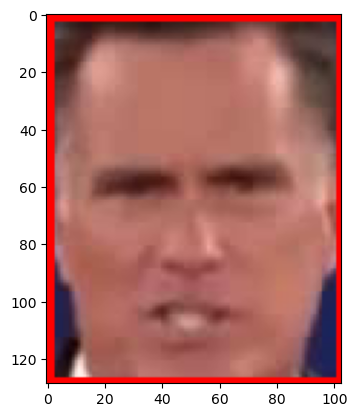

In [4]:
# Plot the template image defined by the bounding box
template = frames_debate[0][y:y + height, x:x + width]
plt.imshow(template)
plt.show()

In [5]:
#Particles generation function
def particle_generation(particles, sigma_d):
    new_particles = []
    for particle in particles:
        x_noise = np.random.normal(0, sigma_d)
        y_noise = np.random.normal(0, sigma_d)
        
        new_x = particle[0] + x_noise
        new_y = particle[1] + y_noise
        
        new_particles.append((new_x, new_y))

    
    return new_particles

In [6]:
def similarity(particles, template, frame, sigma_mse, sim_compare=False, downscores=False):

    weights = []

    for particle in particles:
        x, y = int(particle[0]), int(particle[1])

        # Extract a patch from the frame centered at the particle coordinates
        # Calculate the top-left corner coordinates of the patch
        patch_x = x - template.shape[1] // 2
        patch_y = y - template.shape[0] // 2

        # Calculate the bottom-right corner coordinates of the patch
        patch_x_end = patch_x + template.shape[1]
        patch_y_end = patch_y + template.shape[0]

        # Check if the patch is within the frame boundaries
        if patch_x >= 0 and patch_y >= 0 and patch_x_end <= frame.shape[1] and patch_y_end <= frame.shape[0]:
        # Extract the patch from the frame
            patch = frame[patch_y:patch_y_end, patch_x:patch_x_end]
            patch = patch.astype(np.float32)

            template = template.astype(np.float32)
            # Compute Mean Squared Error (MSE)
            mse = np.sum(np.square(template-patch)) / (template.shape[0] * template.shape[1])

            # Calculate the similarity function
            sim = np.exp(-mse / (2 * sigma_mse**2))
            if downscores==True and sim<1: #We apply it to the pedestrians video to deal with occlusion, in the other videos it performs worse
                sim=0.001
        else:
            sim = 0.0

            # Append the weight to the list
        weights.append(sim)
   
    normalized_weights = weights / np.sum(weights)
       

    if sim_compare:
        return normalized_weights, weights

    # Normalize weights
    
    return normalized_weights


In [7]:
def resampleParticles(particles, weights):
    num_particles = len(particles)
    indices = np.arange(num_particles)

    # Resampling using the low variance sampling algorithm
    selected_indices = np.random.choice(indices, size=num_particles, replace=True, p=weights)

    # The new set of particles after resampling
    resampled_particles = [particles[i] for i in selected_indices]

    return resampled_particles

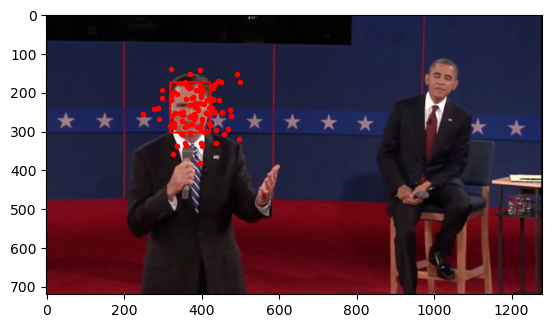

In [8]:
#Initial particle distribution using a gaussian with mean at the center of the bounding box 
num_particles = 100
sigma_d = 50
mean_x = x + width/2
mean_y = y + height/2

particle_x = np.random.normal(mean_x, sigma_d, num_particles)
particle_y = np.random.normal(mean_y, sigma_d, num_particles)

particles= list(zip(particle_x, particle_y))

# Plot the image with particles as red dots
plt.imshow(frames_debate[0])
plt.scatter(particle_x, particle_y, color='red', marker='.')
plt.show()

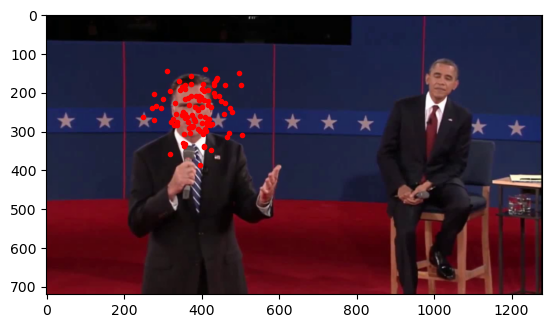

In [9]:
sigma_d=10
round2 = particle_generation(particles, sigma_d)

# Plot the image, frame1, with particles as red dots

plt.imshow(frames_debate[1])
plt.scatter([p[0] for p in round2], [p[1] for p in round2], color='red', marker='.')
plt.show()

In [10]:
#Compute the similarity between the template and the patch around each particle
template = frames_debate[0][y:y + height, x:x + width]
new_weights= similarity(round2, template, frames_debate[1], sigma_mse=10)
resampled_particles= resampleParticles(round2, new_weights)

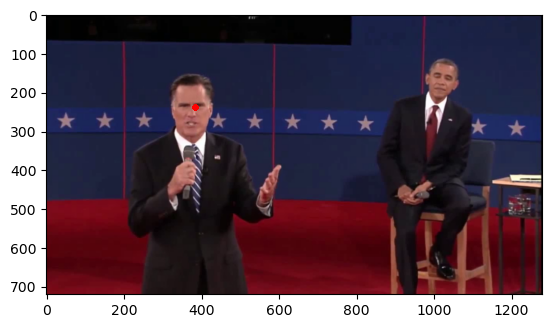

In [11]:
#Plot the new resampled particles
plt.imshow(frames_debate[1])
plt.scatter([particle[0] for particle in resampled_particles], [particle[1] for particle in resampled_particles], color='red', marker='.')
plt.show()

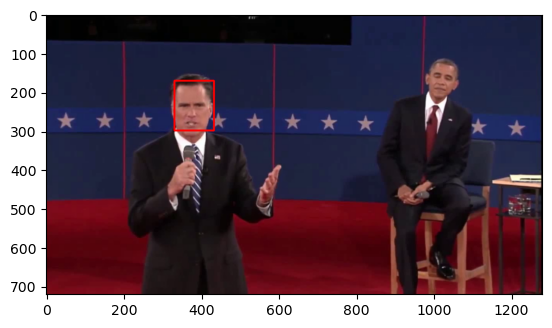

In [12]:
#Calculate the weighted mean of the particles, to compute the new center of the bounding box
x_mean = np.mean([particle[0] for particle in resampled_particles])
y_mean = np.mean([particle[1] for particle in resampled_particles])

# Draw the bounding box on the frame
x_mean, y_mean = int(x_mean), int(y_mean)
cv.rectangle(frames_debate[1], (x_mean - width // 2, y_mean - height // 2), (x_mean + width // 2, y_mean + height // 2), (255, 0, 0), 3)
plt.imshow(frames_debate[1])
plt.show()

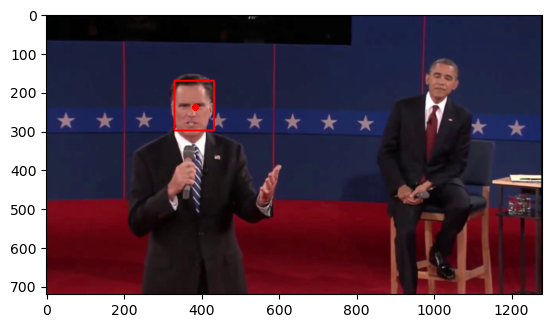

In [13]:
# Calculate the distance of every particle to the weighted mean
distances = [np.sqrt((particle[0] - x_mean)**2 + (particle[1] - y_mean)**2) for particle in resampled_particles]
# Calculate the weighted sum of these distances
weighted_sum = np.sum(np.array(distances) * np.array(new_weights))
# Plot a circle centered at the weighted mean with the calculated radius
circle = matplotlib.patches.Circle((x_mean, y_mean), weighted_sum, color='blue', fill=False)
plt.imshow(frames_debate[1])
plt.scatter([p[0] for p in resampled_particles], [p[1] for p in resampled_particles], color='red', marker='.')
plt.gca().add_patch(circle)
plt.show()

In [14]:
def particle_filter(video_path, box_parm_path, output_video_path, num_initial_particles=100, sigma_init=50, sigma_d=10, sigma_mse=10, width_factor=1, height_factor=1, interest_frames=[28, 84, 144]):
    # Read the first frame in RGB
    frames = process_video(video_path)

    # Read the object bounding box parameters from the press_debate.txt file
    with open(box_parm_path, 'r') as file:
        parameters = file.readline().split()
        x_left_corner, y_left_corner, width, height = map(float, parameters[:4])

    #Compute the coordinates of the centre of the original rectangle
    x = x_left_corner + width/2
    y = y_left_corner + height/2

    #Compute the new width and height
    width = width_factor * width
    height = height_factor * height

    #Compute the new left top corner coordinates
    x_left_corner = x - width/2
    y_left_corner = y - height/2

    #Compute the right bottom corner coordinates
    x_right_corner = x_left_corner + width
    y_right_corner = y_left_corner + height

    # Convert the coordinates to integers
    x_left_corner, y_left_corner, x_right_corner, y_right_corner, height, width = int(x_left_corner), int(y_left_corner), int(x_right_corner), int(y_right_corner), int(height), int(width)
    #First frame
    # Plot the template image defined by the bounding box
    template = frames[0][y_left_corner:y_left_corner + height, x_left_corner:x_left_corner + width]
    plt.imshow(template)
    plt.title(f'Template image, Size factor = {width_factor}')
    plt.show()

    # Draw the bounding box on the first frame
    cv.rectangle(frames[0], (x_left_corner, y_left_corner), (x_right_corner, y_right_corner), (0, 255, 0), 3)

    #Save the first frame with bounding box
    out = cv.VideoWriter(output_video_path, cv.VideoWriter_fourcc(*'mp4v'), 20.0, (frames[0].shape[1], frames[0].shape[0]))
    out.write(cv.cvtColor(frames[0], cv.COLOR_RGB2BGR))

    # Display the frame with the bounding box 
    plt.imshow(frames[0])
    #Add title including the factor value
    plt.title(f'First frame with bounding box, Size factor = {width_factor}')
    plt.show()

    

    # Initialize the list of particles using a gaussian with mean at the center of the bounding box 
    mean_x = x
    mean_y = y

    particle_x = np.random.normal(mean_x, sigma_init, num_initial_particles)
    particle_y = np.random.normal(mean_y, sigma_init, num_initial_particles)

    particles= list(zip(particle_x, particle_y))

    # Process each frame
    for i in range(1, len(frames)):
        # Generate new particles from the previous particles
        particles = particle_generation(particles, sigma_d)

        # Compute the similarity between the template and the patch around each particle
        new_weights= similarity(particles, template, frames[i], sigma_mse)

        # Resample the particles
        particles= resampleParticles(particles, new_weights)

        # Calculate the weighted mean of the particles, to compute the new center of the bounding box
        x_mean = np.mean([particle[0] for particle in particles])
        y_mean = np.mean([particle[1] for particle in particles])

        # Draw the bounding box on the frame
        x_mean, y_mean = int(x_mean), int(y_mean)
        cv.rectangle(frames[i], (x_mean - width // 2, y_mean - height // 2), (x_mean + width // 2, y_mean + height // 2), (0, 255, 0), 3)

        # Calculate the distance of every particle to the weighted mean
        distances = [np.sqrt((particle[0] - x_mean)**2 + (particle[1] - y_mean)**2) for particle in particles]
        # Calculate the weighted sum of these distances
        weighted_sum = np.sum(np.array(distances) * np.array(new_weights))
        # Plot a circle centered at the weighted mean with the calculated radius for the seleted frames
        if i in interest_frames:
            fig, ax = plt.subplots()
            ax.imshow(frames[i])
            ax.scatter([particle[0] for particle in particles], [particle[1] for particle in particles], color='red', marker='.')
            circle = matplotlib.patches.Circle((x_mean, y_mean), weighted_sum, color='green', fill=False)
            ax.add_patch(circle)
            #Add title, including the size factor and frame number
            plt.title(f'Frame {i}, Size factor = {width_factor}, MSE Sigma = {sigma_mse}, Number of Particles = {num_initial_particles}')
            plt.show()

        # Write the frame to the video file
        out.write(cv.cvtColor(frames[i], cv.COLOR_RGB2BGR))

    # Release resources
    out.release()


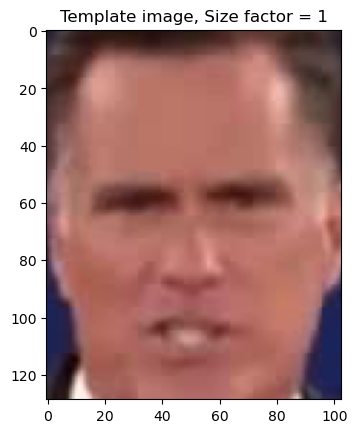

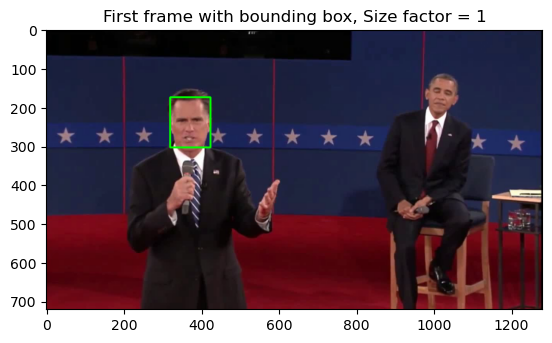

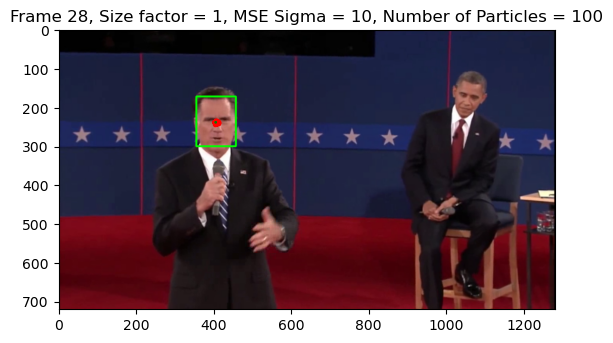

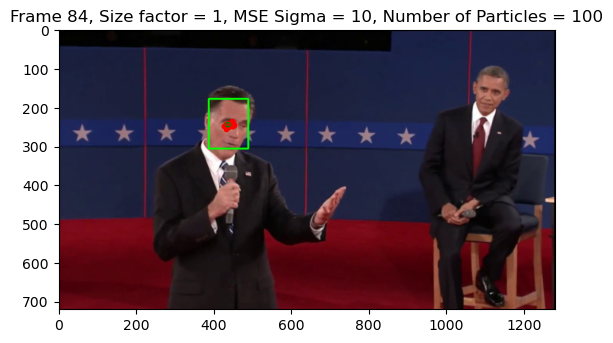

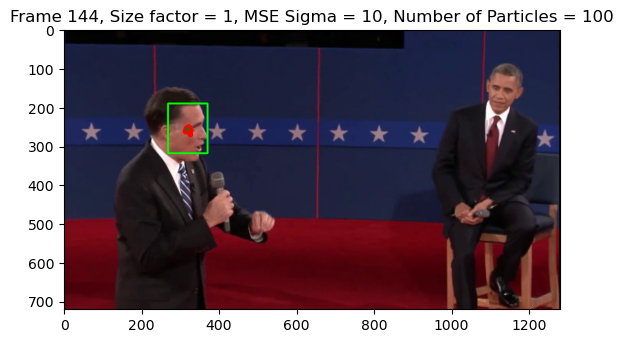

In [15]:
output_video_path = 'pres_debate_particle_filter.avi'
particle_filter('pres_debate.avi', 'pres_debate.txt',output_video_path, num_initial_particles=100, sigma_init=50, sigma_d=10, sigma_mse=10)

1.2 Experiment with different dimensions for the window image patch you are trying to track.
Decrease the window size until the performance of the tracker degrades significantly. Try
significantly larger windows than what worked in 1.1. Discuss the trade-offs of window size
and what makes some image patches work better than others for tracking.

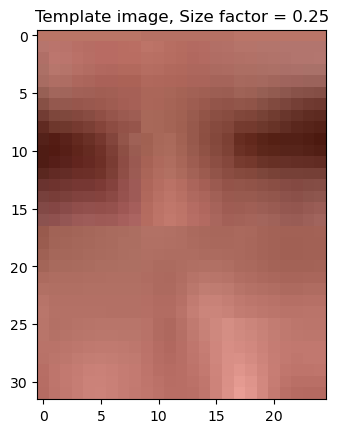

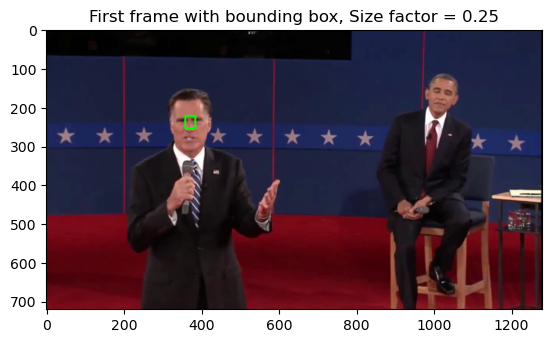

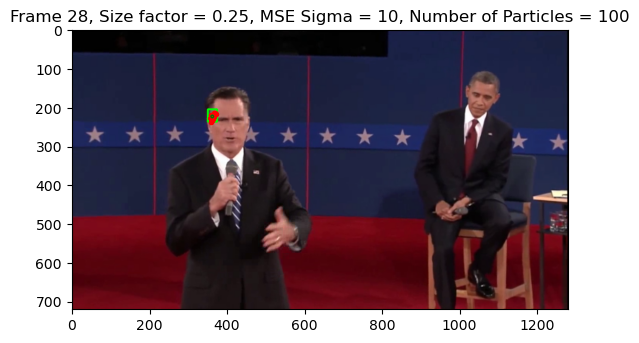

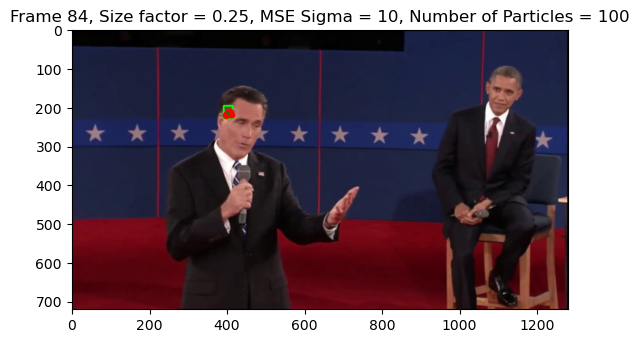

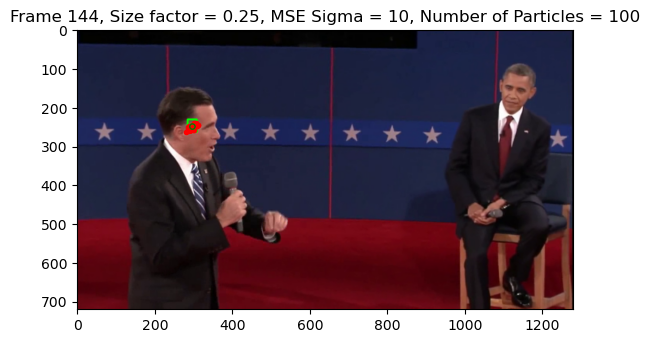

...

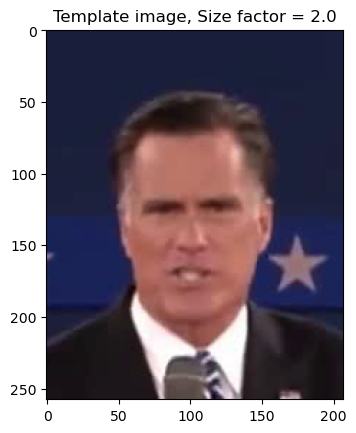

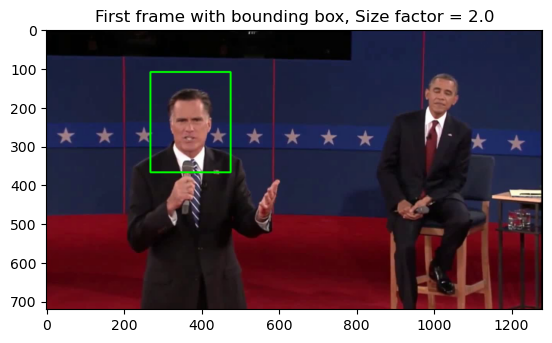

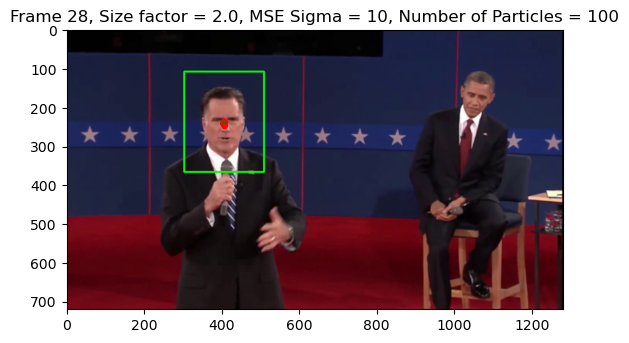

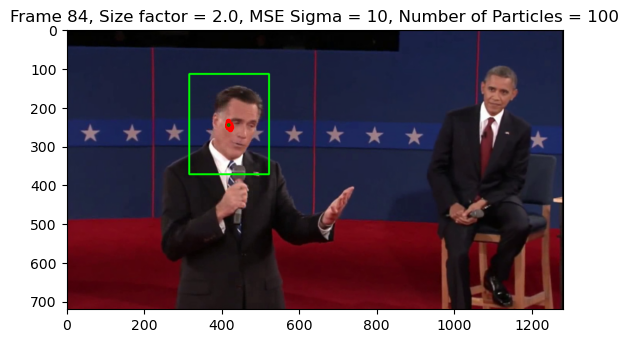

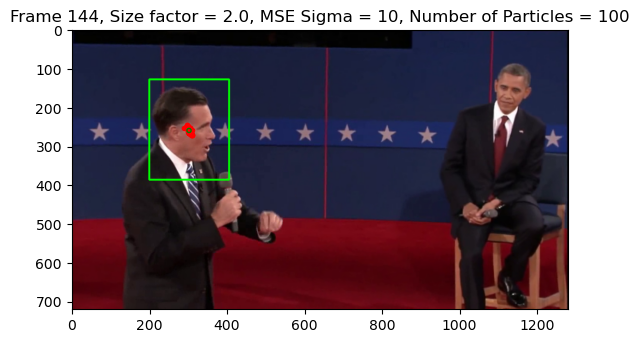

In [16]:
size = [0.25, 0.5, 0.75, 1.0, 1.5, 2.0] 
for x in size:
    particle_filter('pres_debate.avi', 'pres_debate.txt',output_video_path, width_factor=x, height_factor=x)

According to the results obtained for the different windows sizes, we can get some relevant conclusions.
If the window size is too small, like dividing the original height and width by 4, the particle's mean goes away from the face as soon as there is some movement. The particles tend to go to the black part of the background, this might be because a higher proportion of the template are the eyebrows of the face, and when computing the MSE function there is more similarity with the black background.

As there is randomness in the gaussian functions, we never obtain the same result twice, but with sizes of the template window of 0.5, 0.75 and 1 times the original size, we get similar, and the best results. This is because it captures a more faithfull representation of the face. However, the best results are obtained using a template window of half of the size of the original. This is likely to be because it captures the best proportion of the face, without including other colors like the black hair that lead to worse performance in the similarity functions.

When the template window is bigger than that, it also captures blue in the background, so when computing the similarity function, the particles move to the blue background faster than to the face.

1.3 Adjust the σMSE parameter to higher and lower values and run the tracker. Discuss how
changing this parameter alters the results and attempt to explain why

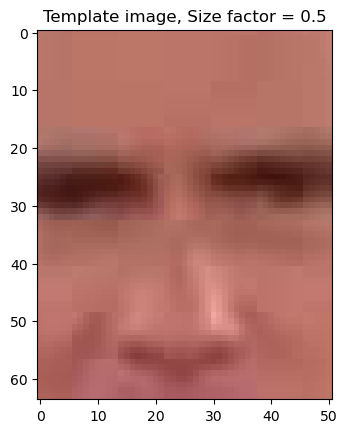

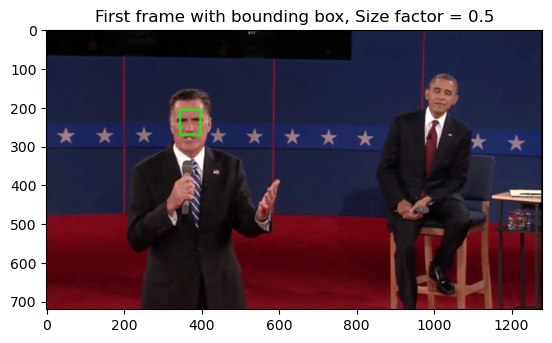

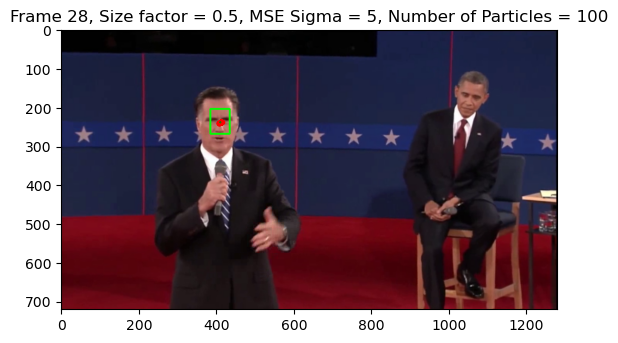

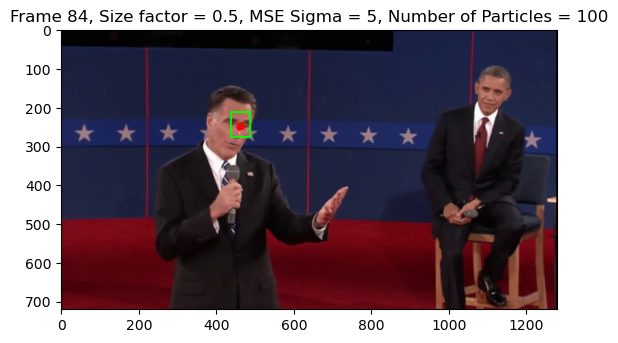

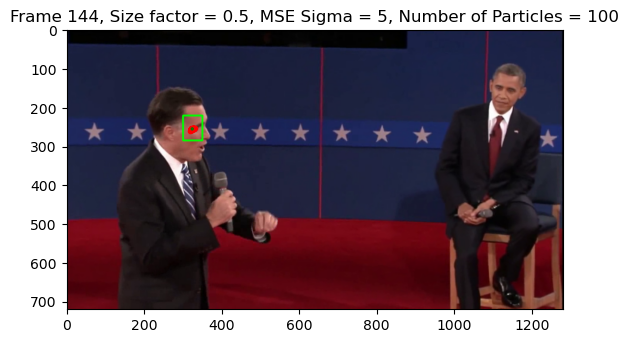

...

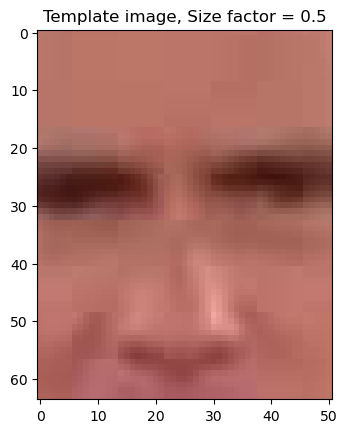

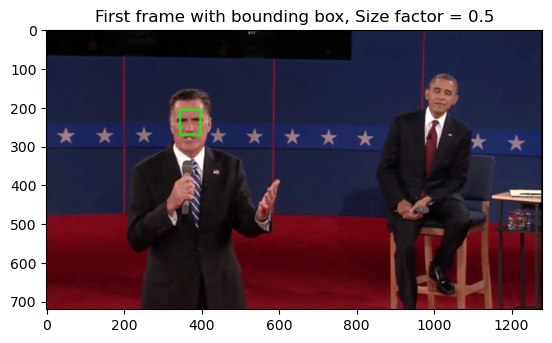

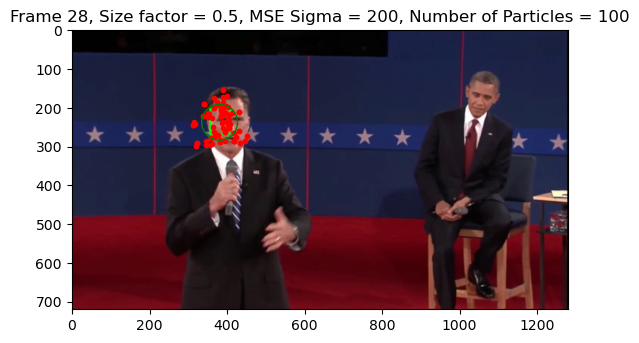

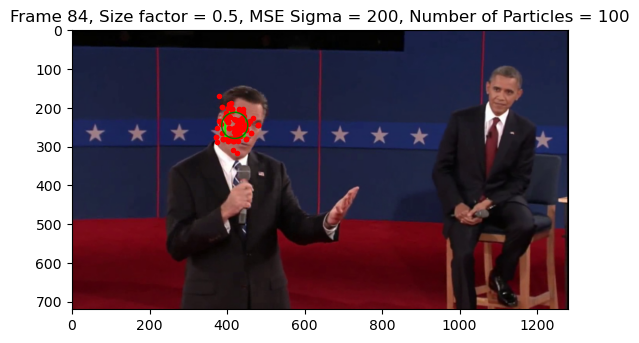

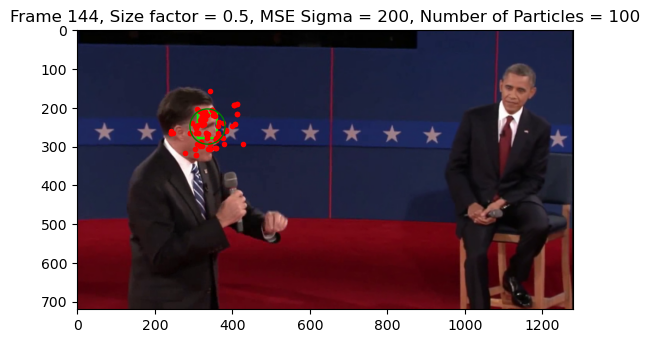

In [21]:
sigma_mse = [5, 50, 100, 200]

for x in sigma_mse:
    particle_filter('pres_debate.avi', 'pres_debate.txt',output_video_path, sigma_mse=x, width_factor=0.5, height_factor=0.5)


With a higher value of the sigma_mse, the similarity function is less affected by changes in the MSE, therefore, the particles tend to have a higher dispersion.
With a lower value, the weights have more importance and the particles tend to be closer to each other and to the one with a higher value of the similarity function.

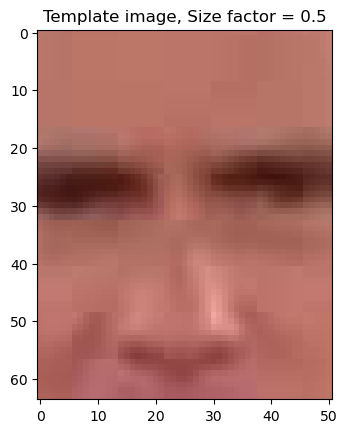

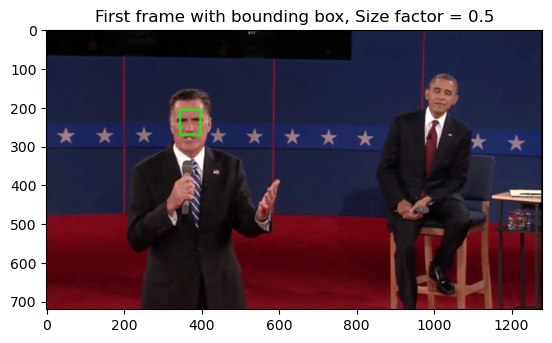

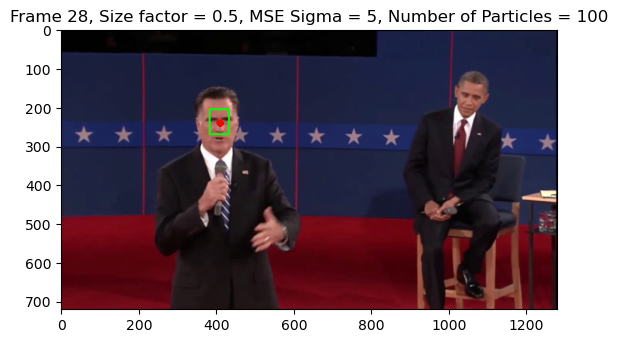

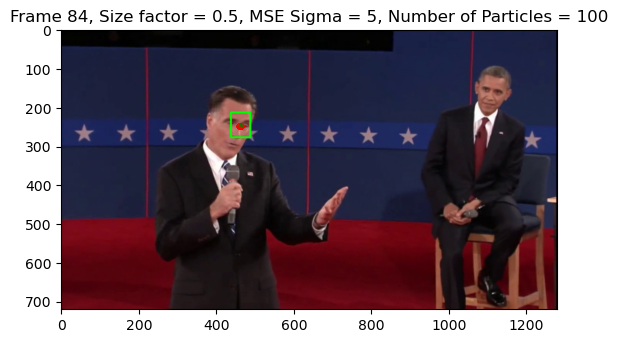

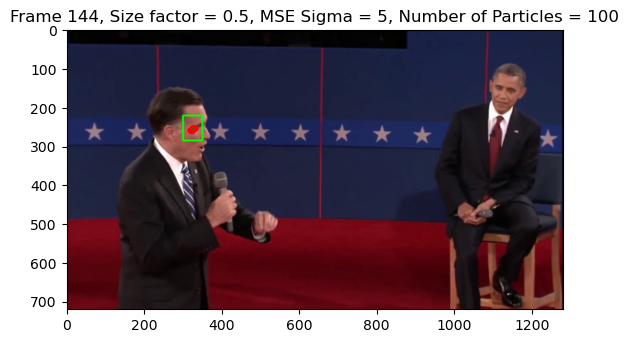

In [22]:
particle_filter('pres_debate.avi', 'pres_debate.txt',output_video_path, sigma_mse=5, width_factor=0.5, height_factor=0.5)

1.4 Try and optimize the number of particles needed to track the target. Discuss the trade-offs of
using a larger number of particles to represent the distribution.

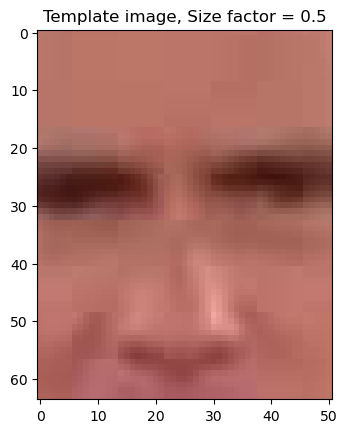

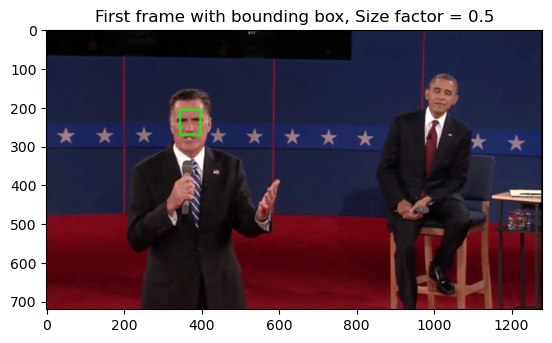

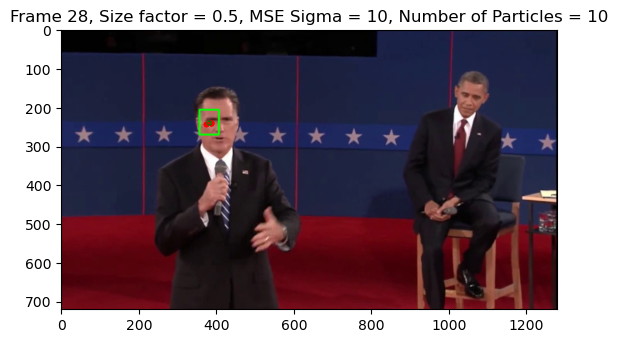

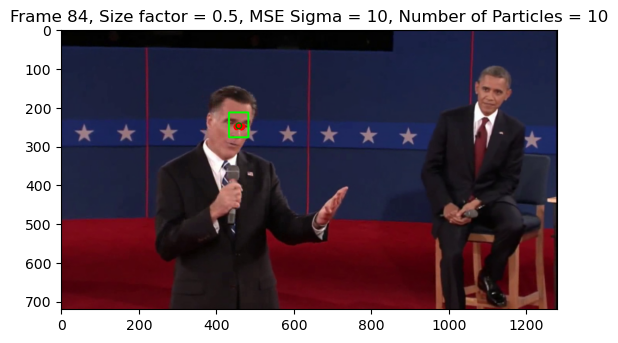

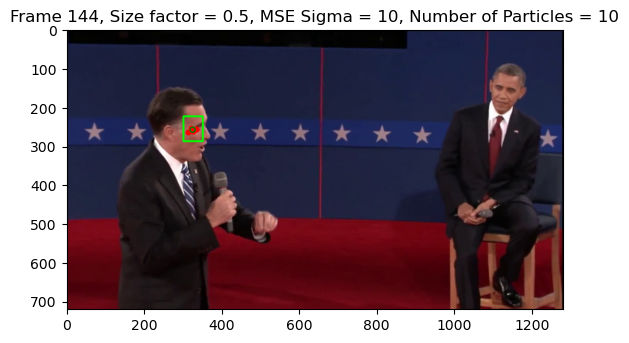

...

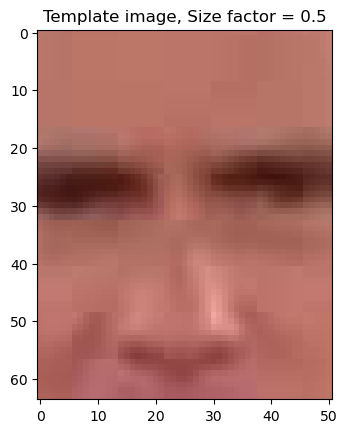

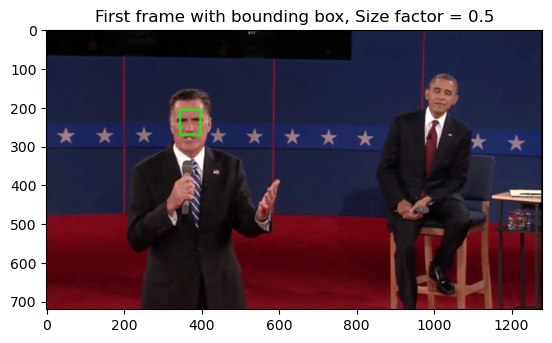

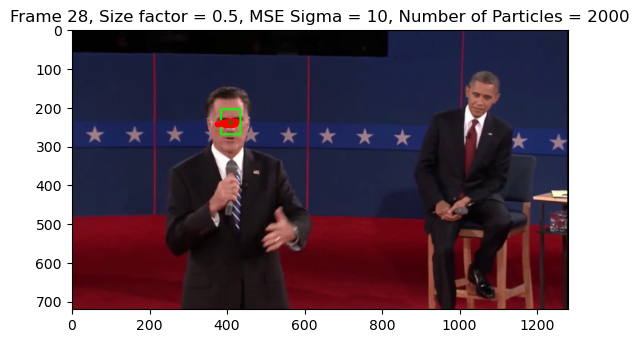

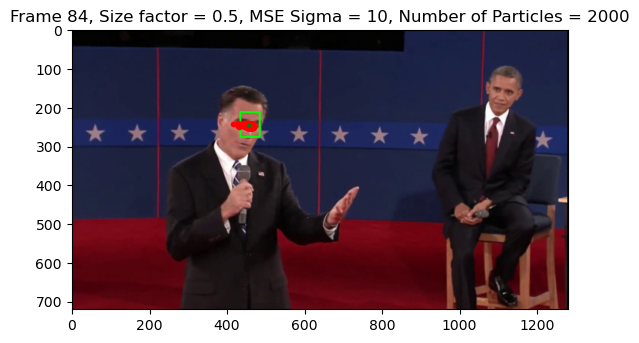

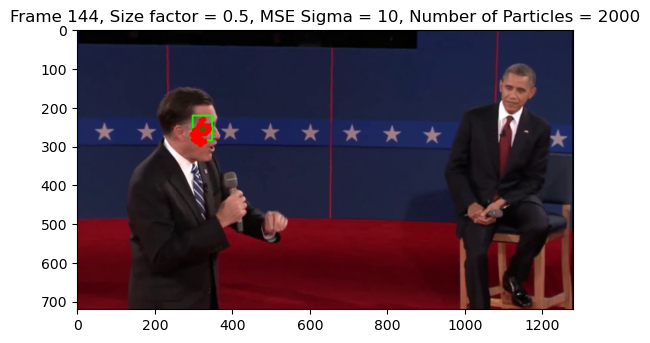

In [23]:
x = [10, 100, 500, 1000, 2000]
for x in x:
    particle_filter('pres_debate.avi', 'pres_debate.txt',output_video_path, sigma_mse=10, width_factor=0.5, height_factor=0.5, num_initial_particles=x)


Using a high number of particles should be better in terms of accuracy as there are more posible box centers that can be similar to the original template, and you get more samples, what is always a better idea when dealing with some randomness. However, the computational cost highly increases.

1.5 Run your tracker on noisy debate.avi and see what happens. Tune your parameters so that the
cluster is able to latch back onto his face after the noise disappears. Include varying σMSE.
Report how the particles respond to increasing and decreasing noise. Save the video frames
14, 32, and 46 with the visualizations overlaid.

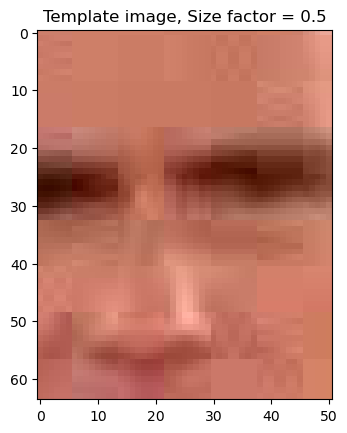

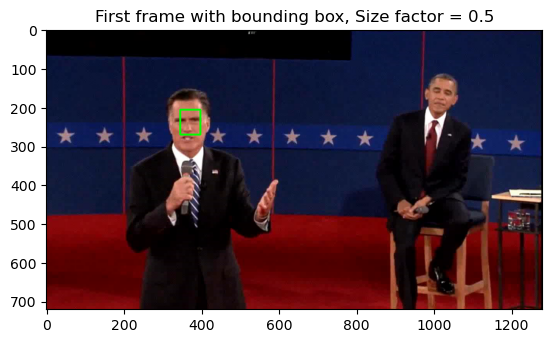

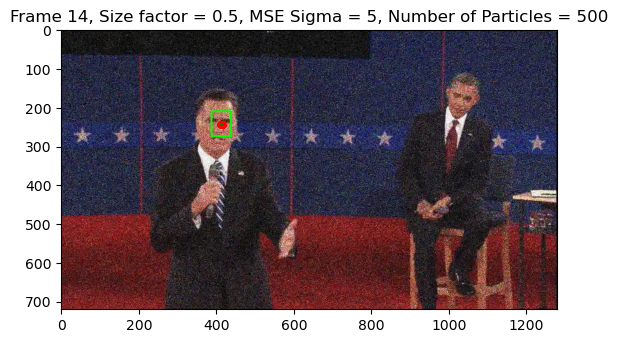

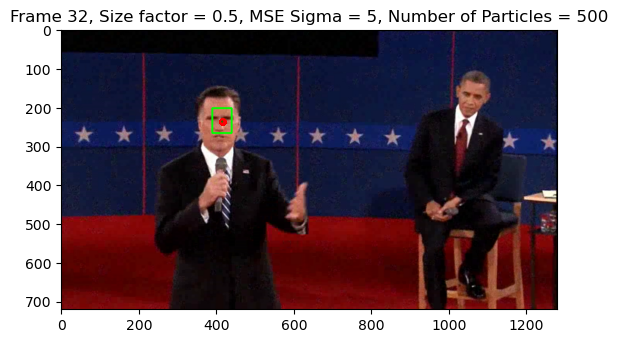

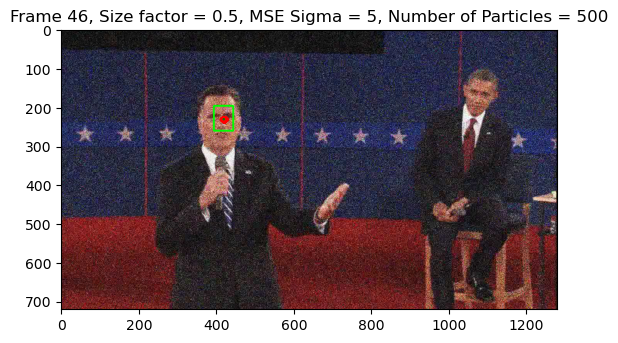

In [24]:
interest_frames = [14, 32, 46]
particle_filter('noisy_debate.avi', 'noisy_debate.txt',output_video_path, sigma_mse=5, width_factor=0.5, height_factor=0.5, num_initial_particles=500, interest_frames=interest_frames)

The code was able to successfully detect with the initial parameters the face in the proposed frames. However, after analysing the video with all the frames, after he turns around, it was not able to track the face anymore.

Changing the sigma MSE value to 5, produced way better results and it tracks the face successfully for all the frames.

2. Modify your existing tracker to include a step which uses the history to update the tracking window
model. We can accomplish this using what’s called an Infinite Impulse Response (IIR) filter. The
concept is simple: we first find the best tracking window for the current particle distribution as
displayed in the visualizations. Then we just update the current window model to be a weighted
sum of the last model and the current best estimate.
Template(t) = α Best(t) + (1 − α) * Template(t − 1)
where Best(t) is the patch of the best estimate or mean estimate. It’s easy to see that by recursively
updating this sum, the window implements an exponentially decaying weighted sum of (all) the
past windows.

In [25]:
def resize(image, scale_factor):

    #Original dimensions
    height= image.shape[0]*scale_factor
    width= image.shape[1]*scale_factor
    new_height= round(height)
    new_width= round(width)


    # Resize the image using the calculated dimensions
    resized_image = cv.resize(image, (new_width, new_height))

    return resized_image

In [26]:
#Function to implement the template update
def template_update(prev_template, alpha, frame_number, frames, width, height, x_center, y_center):

    x_left_corner = round(x_center - width/2)
    y_left_corner = round(y_center - height/2)
    new_template =  frames[frame_number][y_left_corner:y_left_corner + height, x_left_corner:x_left_corner + width]
    # if new_template.shape == (293,0,3) :
        # print(x_center, y_center)
        # print(x_left_corner, y_left_corner)
        # print(height, width)

    if prev_template.shape != new_template.shape:
        
        new_template = cv.resize(new_template, (prev_template.shape[1], prev_template.shape[0]))

    

    #Check they have the same size
    if prev_template.shape != new_template.shape:
        print('The two templates have different sizes')
        print(f'Previous size: {prev_template.shape}, new_size: {new_template.shape}')
        return prev_template
    template = (1 - alpha) * prev_template + alpha * new_template

    return template    

    

In [27]:
def IIR_particle_filter(video_path, box_parm_path, output_video_path = 'hand_particle_filter.avi', num_initial_particles=100, sigma_init=50, sigma_d=10, sigma_mse=10, width_factor=1, height_factor=1, interest_frames=[28, 84, 144], alpha = 0.5, template_file=True, top_left_corner = (525,375), dimensions = (90,120), frame_template = 0):
    # Read the frames in RGB
    frames = process_video(video_path)
    if template_file:
    # Read the object bounding box parameters from the press_debate.txt files
        with open(box_parm_path, 'r') as file:
            parameters = file.readline().split()
            x_left_corner, y_left_corner, width, height = map(float, parameters[:4])

    #To use a custom template not extracted from a file, when template_file = False
    else:
        x_left_corner, y_left_corner = top_left_corner
        width, height = dimensions

    #Compute the coordinates of the centre of the original rectangle
    x = x_left_corner + width/2
    y = y_left_corner + height/2

    #Compute the new width and height
    width = width_factor * width
    height = height_factor * height

    #Compute the new left top corner coordinates
    x_left_corner = x - width/2
    y_left_corner = y - height/2

    #Compute the right bottom corner coordinates
    x_right_corner = x_left_corner + width
    y_right_corner = y_left_corner + height

    # Convert the coordinates to integers
    x_left_corner, y_left_corner, x_right_corner, y_right_corner, height, width = int(x_left_corner), int(y_left_corner), int(x_right_corner), int(y_right_corner), int(height), int(width)
    #First frame
    # Plot the template image defined by the bounding box
    template = frames[frame_template][y_left_corner:y_left_corner + height, x_left_corner:x_left_corner + width]
    plt.imshow(template)
    plt.title(f'Initial template image, Size factor = {width_factor}')
    plt.show()

    # Draw the bounding box on the first frame
    cv.rectangle(frames[0], (x_left_corner, y_left_corner), (x_right_corner, y_right_corner), (0, 255, 0), 3)

    #Save the first frame with bounding box
    out = cv.VideoWriter(output_video_path, cv.VideoWriter_fourcc(*'mp4v'), 20.0, (frames[0].shape[1], frames[0].shape[0]))
    out.write(cv.cvtColor(frames[0], cv.COLOR_RGB2BGR))


    # Initialize the list of particles using a gaussian with mean at the center of the bounding box 
    x_mean = x
    y_mean = y

    particle_x = np.random.normal(x_mean, sigma_init, num_initial_particles)
    particle_y = np.random.normal(y_mean, sigma_init, num_initial_particles)

    particles= list(zip(particle_x, particle_y))

    # Process each frame
    for i in range(1, len(frames)):

        # Generate new particles from the previous particles
        particles = particle_generation(particles, sigma_d)

        # Compute the similarity between the template and the patch around each particle
        new_weights= similarity(particles, template, frames[i], sigma_mse)

        # Resample the particles
        particles= resampleParticles(particles, new_weights)

        # Calculate the weighted mean of the particles, to compute the new center of the bounding box, multiplying it by the weight components in new_weights
        x_mean = np.sum([particle[0] * weight for particle, weight in zip(particles, new_weights)])
        y_mean = np.sum([particle[1] * weight for particle, weight in zip(particles, new_weights)])
        
        x_mean, y_mean = int(x_mean), int(y_mean)

        

        # Draw the bounding box on the frame
        cv.rectangle(frames[i], (x_mean - width // 2, y_mean - height // 2), (x_mean + width // 2, y_mean + height // 2), (0, 255, 0), 3)

        # Calculate the distance of every particle to the weighted mean
        distances = [np.sqrt((particle[0] - x_mean)**2 + (particle[1] - y_mean)**2) for particle in particles]
        # Calculate the weighted sum of these distances
        weighted_sum = np.sum(np.array(distances) * np.array(new_weights))
        # Plot a circle centered at the weighted mean with the calculated radius for the seleted frames
        if i in interest_frames:
            fig, ax = plt.subplots()
            ax.imshow(frames[i])
            ax.scatter([particle[0] for particle in particles], [particle[1] for particle in particles], color='red', marker='.')
            circle = matplotlib.patches.Circle((x_mean, y_mean), weighted_sum, color='green', fill=False)
            ax.add_patch(circle)
            #Add title, including the size factor and frame number
            plt.title(f'Frame {i}, MSE Sigma = {sigma_mse}, Number of Particles = {num_initial_particles}, Alpha = {alpha}')
            plt.show()

        template = template_update(prev_template=template, alpha=alpha, frame_number=i, frames=frames, width=width, height=height, x_center=x_mean, y_center=y_mean)
        # plt.imshow(template)
        # plt.title(f'Frame {i} template')
        # plt.show()

        # Write the frame to the video file
        for particle in particles:
            cv.circle(frames[i], (int(particle[0]), int(particle[1])), 3, (255, 0, 0))
        out.write(cv.cvtColor(frames[i], cv.COLOR_RGB2BGR))

    # Release resources
    out.release()

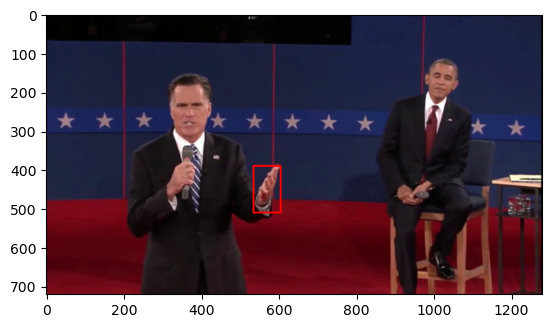

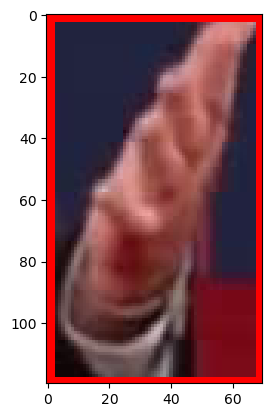

In [28]:
#Let's look at the hand in the initial frame
frames_debate= process_video('pres_debate.avi')
x= 535
y= 390
width= 70
height= 120
x, y, width, height = int(x), int(y), int(width), int(height)
cv.rectangle(frames_debate[0], (x, y), (x + width, y + height), (255, 0, 0), 3)

# Display the frame with the bounding box
plt.imshow(frames_debate[0])
plt.show()

# Plot the template image defined by the bounding box
template = frames_debate[0][y:y + height, x:x + width]
plt.imshow(template)
plt.show()


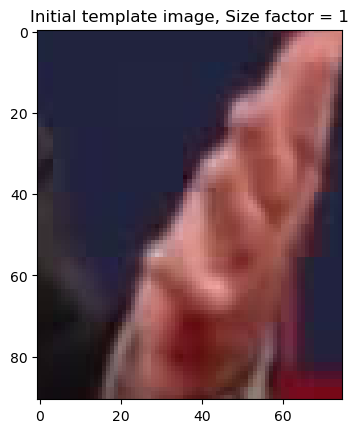

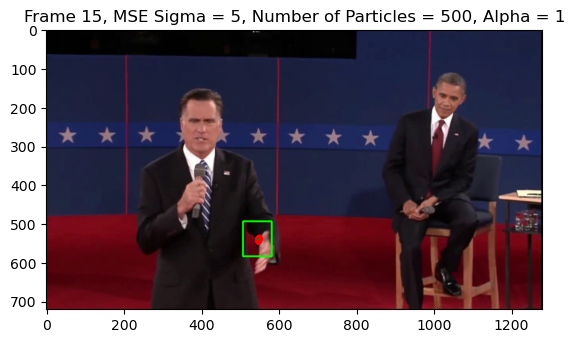

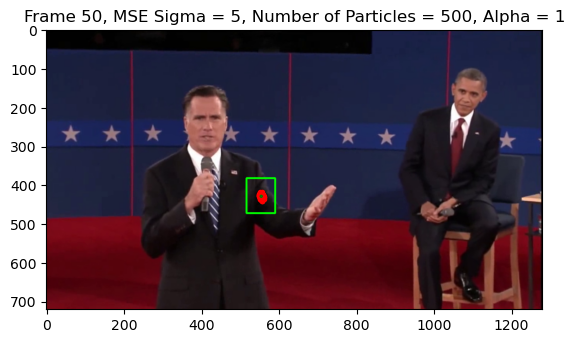

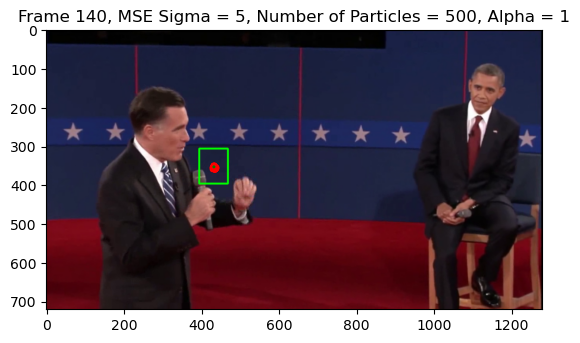

In [29]:
#Let's see how it works with the previous tracking system: alpha = 1
interest_frames = [15, 50, 140]
IIR_particle_filter('pres_debate.avi', 'hand.txt', sigma_mse=5, width_factor=1, height_factor=1, num_initial_particles=500, interest_frames=interest_frames, alpha=1)

We see that using the "naïve" it is not able to track the hand using the template in the first frame. Let's try with different alpha values.

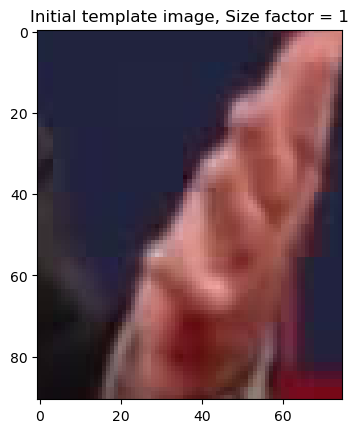

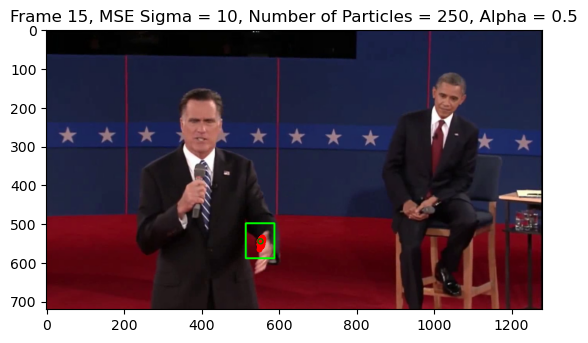

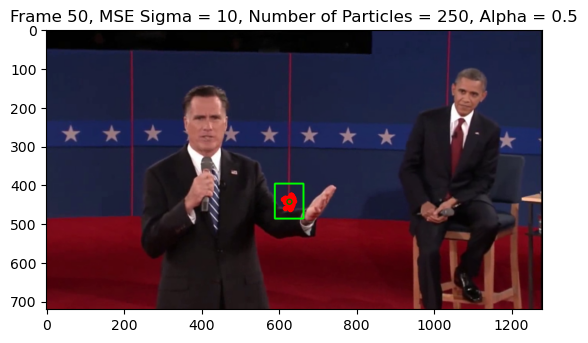

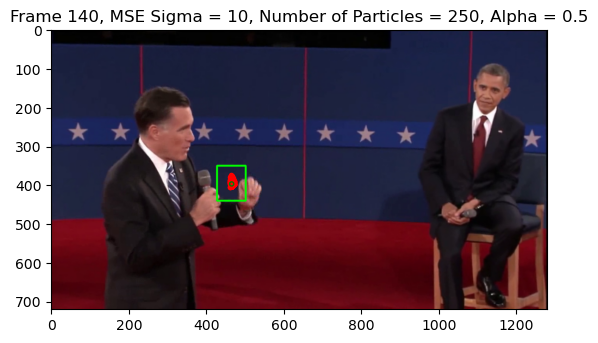

In [30]:
alpha= 0.5
interest_frames = [15, 50, 140]
IIR_particle_filter('pres_debate.avi', 'hand.txt', sigma_mse=10, num_initial_particles=250, interest_frames=interest_frames, alpha=alpha)

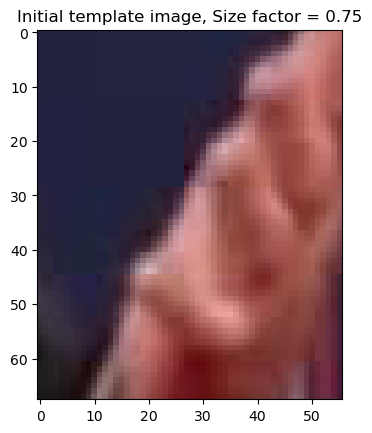

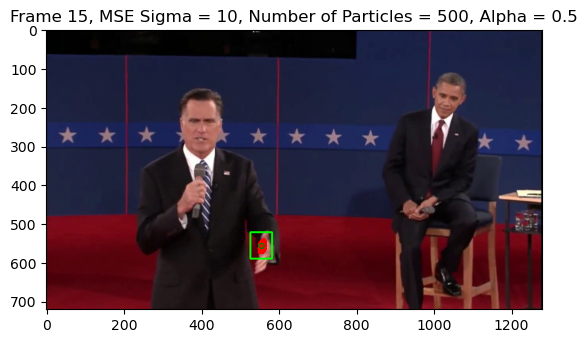

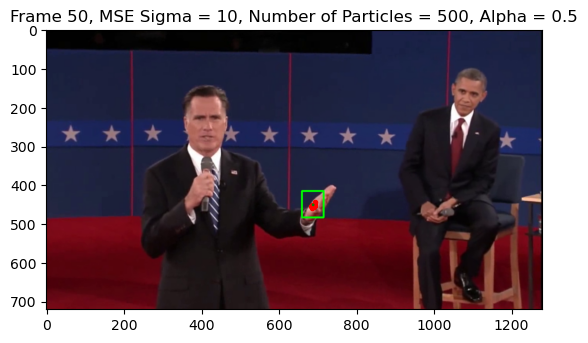

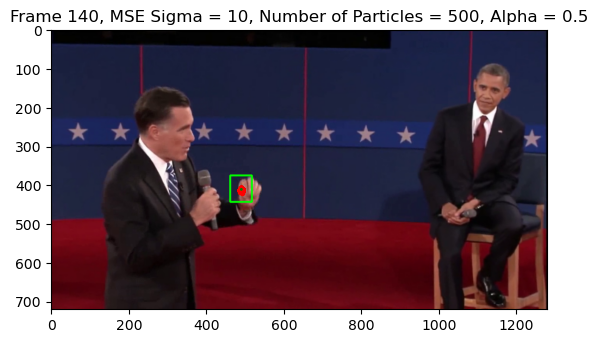

In [31]:
alpha= 0.5
IIR_particle_filter('pres_debate.avi', 'hand.txt', sigma_mse=10, sigma_d=20,width_factor=.75, height_factor=.75, num_initial_particles=500, interest_frames=interest_frames, alpha=alpha )

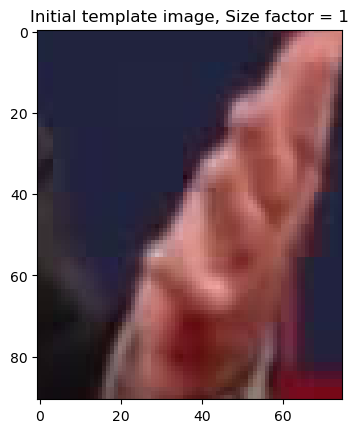

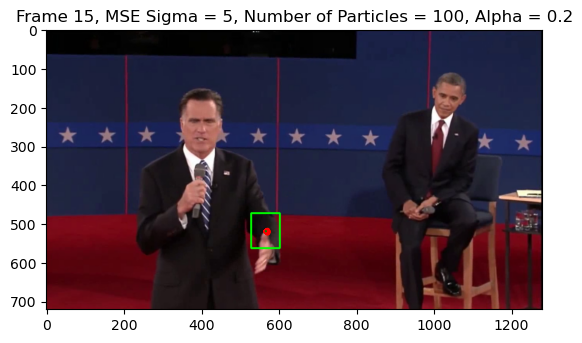

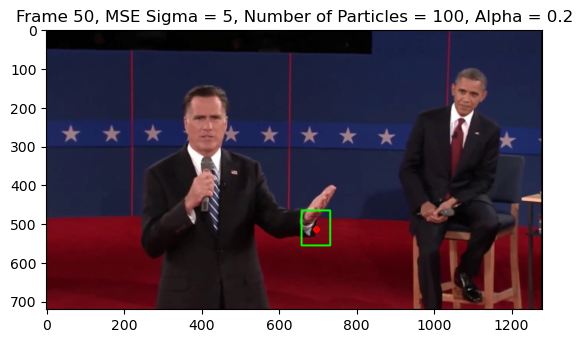

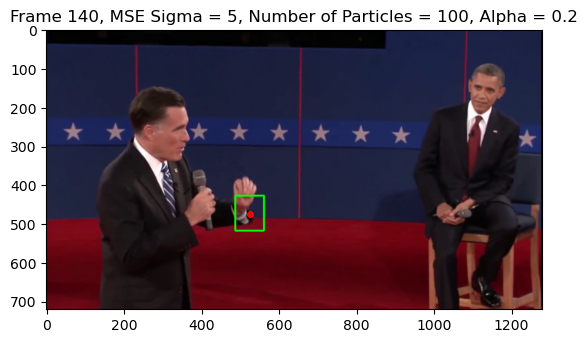

In [32]:
alpha= 0.2
IIR_particle_filter('pres_debate.avi', 'hand.txt', sigma_mse=5, sigma_d=5, width_factor=1, height_factor=1, num_initial_particles=100, interest_frames=interest_frames, alpha=alpha)

2.2 Try running the tracker on noisy debate.avi. Adjust the parameters until you are able to track
the hand all the way to frame 140. Indicate what parameters you had to change to get this
to work on the noisy video and discuss why this would be the case.


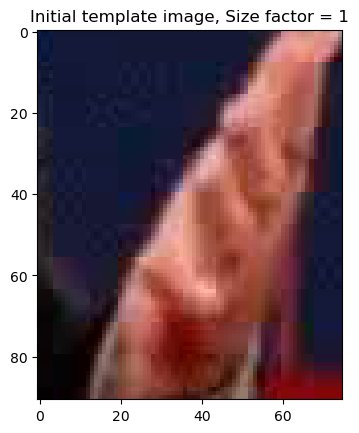

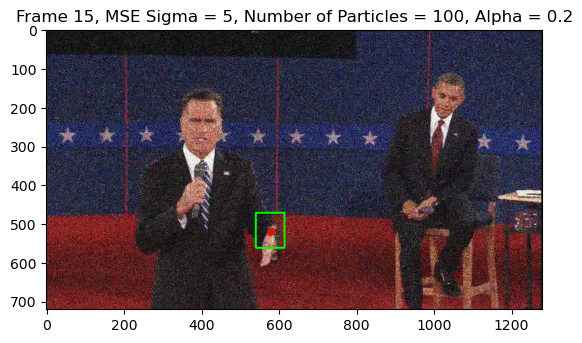

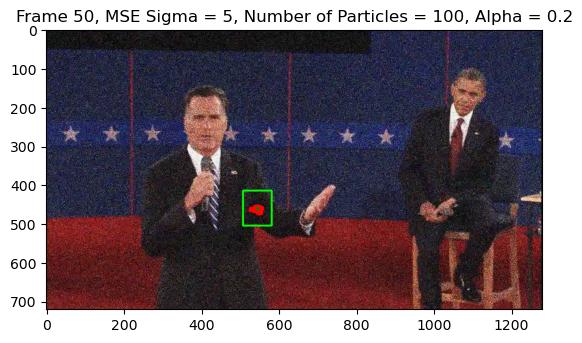

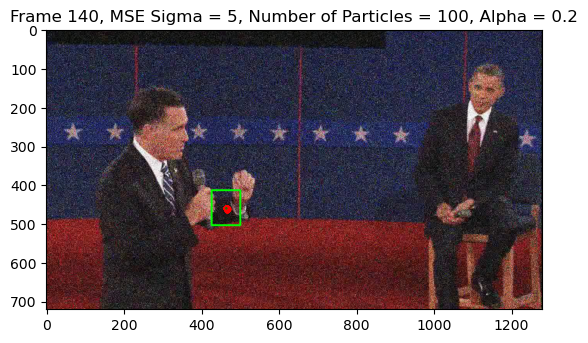

In [33]:
alpha= 0.2
IIR_particle_filter('noisy_debate.avi', 'hand.txt', sigma_mse=5, sigma_d=5, width_factor=1, height_factor=1, num_initial_particles=100, interest_frames=interest_frames, alpha=alpha, output_video_path='noisy_hand_particle_filter.avi')

I got the best results with an alpha value of 0.2, sigma_mse=5, sigma_d=5 and 100 particles.
I find suprising that it works better with 100 than with a higher number like 500, this might be because with a higher number of particles there is more dispersion from the previous template and tends to have a lower MSE with parts of the image that are similar in the colors to the template, but not the object we are aiming to track.
Also found that low values of sigma_mse and sigma_d lead to better results.

3. Incorporating More Dynamics
Expand your appearance model to include window size as another parameter. Run the tracker and save the video frames 40, 100, and 240 with the visualizations overlaid.

Let's try with the current tracker we used to track Romney's hand and analyze the results.

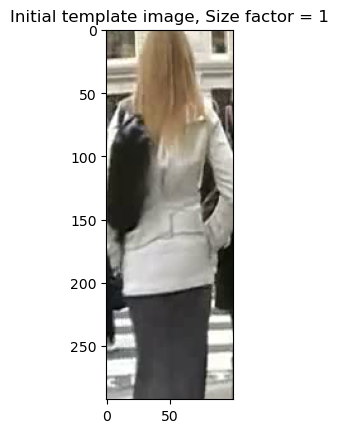

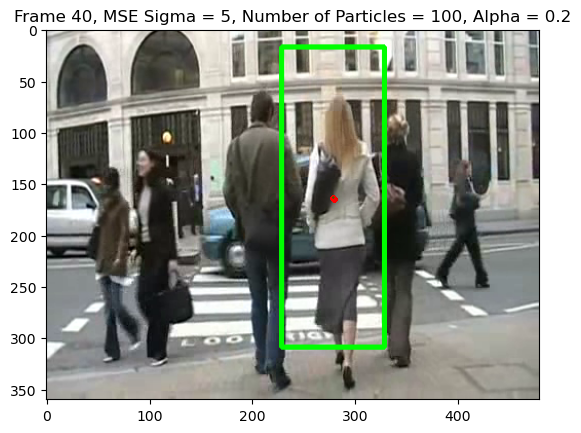

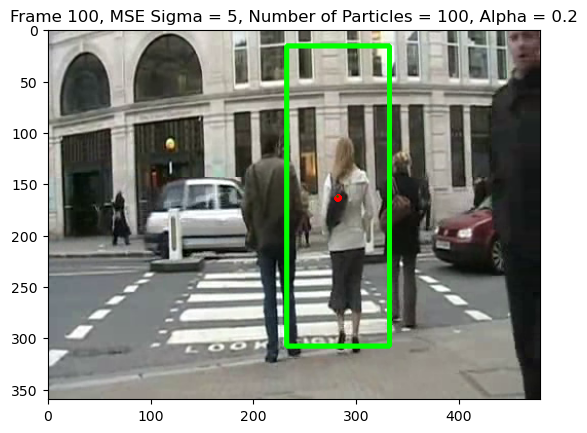

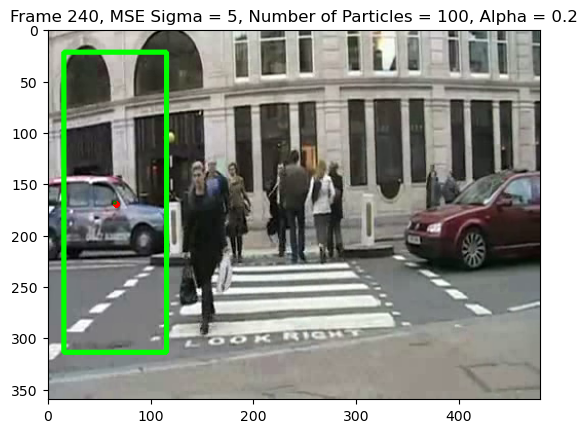

In [34]:
alpha= 0.2
interest_frames = [40, 100, 240]
IIR_particle_filter('pedestrians.avi', 'pedestrians.txt', sigma_mse=5, sigma_d=5, width_factor=1, height_factor=1, num_initial_particles=100, interest_frames=interest_frames, alpha=alpha, output_video_path='pedestrians_particle_filter.avi')

It does a decent job before the occlusion, but it does not adapt the window size to the actual size of the woman while she walks away.

In [35]:
def resize(image, scale_factor):

    #Original dimensions
    height= image.shape[0]*scale_factor
    width= image.shape[1]*scale_factor
    new_height= round(height)
    new_width= round(width)

    #Ensure positive dimensions
    if new_height < 0 or new_width < 0:
        raise ValueError("Negative new dimensions")

    # Resize the image using the calculated dimensions
    resized_image = cv.resize(image, (new_width, new_height))

    return resized_image

In [38]:
def adaptative_particle_filter(video_path, box_parm_path, output_video_path = 'hand_particle_filter.avi', num_initial_particles=100, sigma_init=50, sigma_d=10, sigma_mse=10, width_factor=1, height_factor=1, interest_frames=[28, 84, 144], alpha = 0.5, template_file=True, top_left_corner = (525,375), dimensions = (90,120), frame_template = 0, ntry=10, downscores=False):
    # Read the frames in RGB
    frames = process_video(video_path)
    if template_file:
    # Read the object bounding box parameters from the press_debate.txt files
        with open(box_parm_path, 'r') as file:
            parameters = file.readline().split()
            x_left_corner, y_left_corner, width, height = map(float, parameters[:4])

    #To use a custom template not extracted from a file, when template_file = False
    else:
        x_left_corner, y_left_corner = top_left_corner
        width, height = dimensions

    #Compute the coordinates of the centre of the original rectangle
    x = x_left_corner + width/2
    y = y_left_corner + height/2

    #Compute the new width and height
    width = width_factor * width
    height = height_factor * height

    #Compute the new left top corner coordinates
    x_left_corner = x - width/2
    y_left_corner = y - height/2

    #Compute the right bottom corner coordinates
    x_right_corner = x_left_corner + width
    y_right_corner = y_left_corner + height

    # Convert the coordinates to integers
    x_left_corner, y_left_corner, x_right_corner, y_right_corner, height, width = int(x_left_corner), int(y_left_corner), int(x_right_corner), int(y_right_corner), int(height), int(width)
    #First frame
    # Plot the template image defined by the bounding box
    template = frames[frame_template][y_left_corner:y_left_corner + height, x_left_corner:x_left_corner + width]
    plt.imshow(template)
    plt.title(f'Initial template image, Size factor = {width_factor}')
    plt.show()

    #Draw the bounding box on the frame using cv.rectangle
    cv.rectangle(frames[0], (x_left_corner, y_left_corner), (x_right_corner, y_right_corner), (0, 255, 0), 3)

    #Save the first frame with bounding box
    out = cv.VideoWriter(output_video_path, cv.VideoWriter_fourcc(*'mp4v'), 20.0, (frames[0].shape[1], frames[0].shape[0]))
    out.write(cv.cvtColor(frames[0], cv.COLOR_RGB2BGR))


    # Initialize the list of particles using a gaussian with mean at the center of the bounding box 
    x_mean = x
    y_mean = y

    particle_x = np.random.normal(x_mean, sigma_init, num_initial_particles)
    particle_y = np.random.normal(y_mean, sigma_init, num_initial_particles)

    particles= list(zip(particle_x, particle_y))

    # Process each frame
    for i in range(1, len(frames)):

        # Generate new particles from the previous particles
        particles = particle_generation(particles, sigma_d)

        # Compute the similarity between the template and the patch around each particle
        new_weights= similarity(particles, template, frames[i], sigma_mse, downscores=downscores)

        # Resample the particles
        particles= resampleParticles(particles, new_weights)

        # Calculate the weighted mean of the particles, to compute the new center of the bounding box, multiplying it by the weight components in new_weights
        x_mean = np.sum([particle[0] * weight for particle, weight in zip(particles, new_weights)])
        y_mean = np.sum([particle[1] * weight for particle, weight in zip(particles, new_weights)])
        
        x_mean, y_mean = int(x_mean), int(y_mean)

        #Draw the bounding box on the frame using cv.rectangle, with center in x_mean, y_mean and the template size
        cv.rectangle(frames[i], (x_mean - template.shape[1] // 2, y_mean - template.shape[0] // 2), (x_mean + template.shape[1] // 2, y_mean + template.shape[0] // 2), (0, 255, 0), 3)
        # Draw the bounding box on the frame
        #cv.rectangle(frames[i], (x_mean - width // 2, y_mean - height // 2), (x_mean + width // 2, y_mean + height // 2), (0, 255, 0), 3)

        # Calculate the distance of every particle to the weighted mean
        distances = [np.sqrt((particle[0] - x_mean)**2 + (particle[1] - y_mean)**2) for particle in particles]
        # Calculate the weighted sum of these distances
        weighted_sum = np.sum(np.array(distances) * np.array(new_weights))
        # Plot a circle centered at the weighted mean with the calculated radius for the seleted frames
        if i in interest_frames:
            fig, ax = plt.subplots()
            ax.imshow(frames[i])
            ax.scatter([particle[0] for particle in particles], [particle[1] for particle in particles], color='red', marker='.')
            circle = matplotlib.patches.Circle((x_mean, y_mean), weighted_sum, color='green', fill=False)
            ax.add_patch(circle)
            #Add title, including the size factor and frame number
            plt.title(f'Frame {i}, Alpha = {alpha}, MSE Sigma = {sigma_mse}, Number of Particles = {num_initial_particles}')
            plt.show()

       #Resize the template according to the highest similarity
        best_template = template
        max_sim = 0
        for s in range(0, ntry):

            if template.shape[0]-s > 0 and template.shape[1]-s > 0:
                new_template = cv.resize(template, (template.shape[1] -s, template.shape[0] -s))
                #Compute the similarity of the particles with the new template
                _, sim = similarity(particles, new_template, frames[i], sigma_mse, sim_compare=True, downscores=downscores)
                #Keep the template with the highest similarity
                total_sim = np.sum(sim)
                if total_sim > max_sim:
                    max_sim = total_sim
                    best_template = new_template
                else:
                    break
        template = best_template

        template = template_update(prev_template=template, alpha=alpha, frame_number=i, frames=frames, width=width, height=height, x_center=x_mean, y_center=y_mean)
        


        # plt.imshow(template)
        # plt.title(f'Frame {i} template')
        # plt.show()

        # Write the frame to the video file
        for particle in particles:
            cv.circle(frames[i], (int(particle[0]), int(particle[1])), 3, (255, 0, 0))
        out.write(cv.cvtColor(frames[i], cv.COLOR_RGB2BGR))

    # Release resources
    out.release()

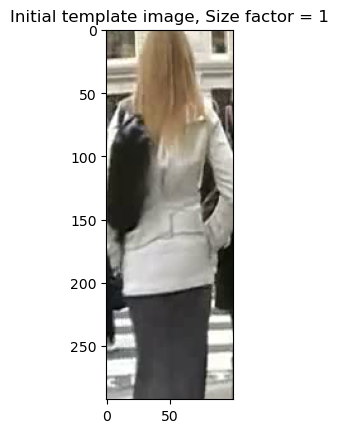

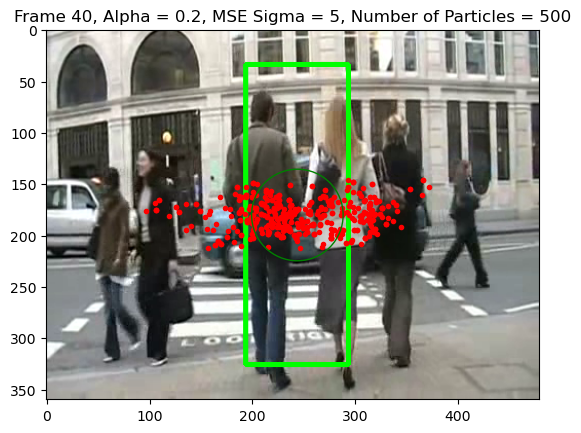

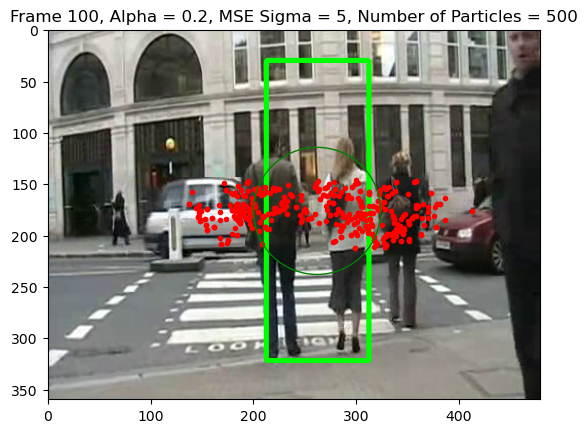

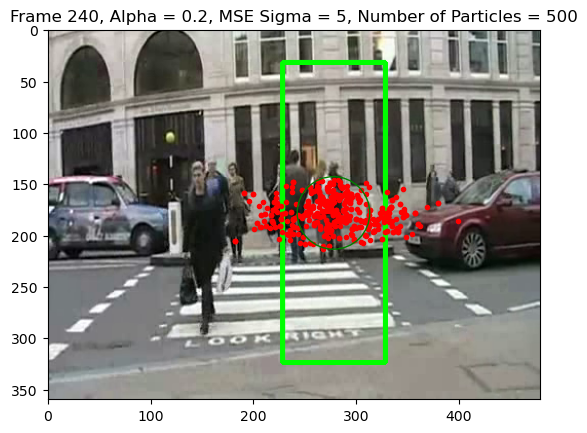

In [39]:
alpha= 0.2
interest_frames = [40, 100, 240]
pixel_reduction_range = 20
adaptative_particle_filter('pedestrians.avi', 'pedestrians.txt', sigma_mse=5, sigma_d=5, width_factor=1, height_factor=1, num_initial_particles=500, interest_frames=interest_frames, alpha=alpha, output_video_path='pedestrians_particle_filter.avi', ntry=pixel_reduction_range, downscores=True)

To deal with occlusion, a condition was introduced to the similarity function so that the weights lower than 1, before normalization, were set to 0.001. This was done to avoid the particles with low similarity disturb the model when the woman is occluded.

In addition, a higher number of particles works better in this more complex model. It can adapt better to changes in the state size and occlusion.